In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
from __future__ import print_function
import argparse
import os

import numpy as np
from keras import backend as K
from keras.callbacks import ModelCheckpoint
from keras.models import Model
from keras.layers import Input
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Flatten, Dense, Dropout
from keras.layers import merge
from keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import list_pictures, array_to_img

from image_ext import list_pictures_in_multidir, load_imgs_asarray

import pickle

np.random.seed(2016)

/home/nakazawa_atsushi/anaconda3/envs/py3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.
/home/nakazawa_atsushi/anaconda3/envs/py3/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


In [2]:
def create_fcn00(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv4)

    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool4)
    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv5)
    pool5 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv5)

    conv6 = Conv2D(1024, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool5)
    conv6 = Conv2D(1024, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv6)

    up7 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv6), conv5])
    conv7 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(up7)
    conv7 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv7)

    up8 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv7), conv4])
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(up8)
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv8)

    up9 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv8), conv3])
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(up9)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv9)

    up10 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv9), conv2])
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(up10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv10)

    up11 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv10), conv1])
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(up11)
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv11)

    conv12 = Conv2D(1, (1, 1), activation='sigmoid', padding='same', data_format='channels_first')(conv11)
    #conv12 = Conv2D(1, 1, 1)(conv11)
    
    fcn = Model(inputs=inputs, outputs=conv12)

    return fcn

In [3]:
def create_fcn01(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv4)

    conv6 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool4)
    conv6 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv6)
    
    up8 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv6), conv4])
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(up8)
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv8)

    up9 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv8), conv3])
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(up9)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv9)

    up10 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv9), conv2])
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(up10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv10)

    up11 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv10), conv1])
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(up11)
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv11)

    conv12 = Conv2D(1, (1, 1), activation='sigmoid', padding='same', data_format='channels_first')(conv11)
    #conv12 = Conv2D(1, 1, 1)(conv11)
    
    fcn = Model(inputs=inputs, outputs=conv12)

    return fcn

In [4]:
def create_fcn02(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_1')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_2')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_1')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_2')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_1')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_2')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_1')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_2')(conv4)

    up9 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv4), conv3])
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv5_1')(up9)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv5_2')(conv9)

    up10 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv9), conv2])
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv6_1')(up10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv6_2')(conv10)

    up11 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv10), conv1])
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv7_1')(up11)
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv7_2')(conv11)

    conv12 = Conv2D(1, (1, 1), activation='sigmoid', padding='same', data_format='channels_first', name='conv8')(conv11)
    #conv12 = Conv2D(1, 1, 1)(conv11)
    
    fcn = Model(inputs=inputs, outputs=conv12)

    return fcn

In [48]:
def create_pupil_net(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_1')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_2')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_1')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_2')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_1')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_2')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_1')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_2')(conv4)

    full01 = Flatten()(pool1)
    #full01 = Dense(100)(full01)
    full02 = Flatten()(pool2)
    #full02 = Dense(100)(full02)
    full03 = Flatten()(pool3)
    #full03 = Dense(100)(full03)
    full04 = Flatten()(conv4)
    #full04 = Dense(100)(full04)
    
    #full = Concatenate()([full01,full02,full03,full04])
    full = Concatenate()([full03,full04])
    full = Dropout(0.5)(full)
    full = Dense(50)(full)
    #full = Dropout(0.5)(full)
    #full = Dense(50)(full)
    out = Dense(2)(full)
    
    fcn = Model(inputs=inputs, outputs=out)

    return fcn

In [49]:
def load_fnames(paths):
    f = open(paths)
    data1 = f.read()
    f.close()
    lines = data1.split('\n')
    #print(len(lines))
    # 最終行は空行なので消す
    del(lines[len(lines)-1])
    #print(len(lines))
    return lines

In [50]:
def make_fnames(fnames,fpath,fpath_mask,mask_ext):
    fnames_img = [];
    fnames_mask= [];
    
    for i in range(len(fnames)):
        fnames_img.append(fpath + '/' + fnames[i]);
        fnames_mask.append(fpath_mask + '/' + mask_ext + fnames[i]);
        
    return [fnames_img,fnames_mask]

In [51]:
def get_center(im):
    im[im>0] = 1;
    xval = 0
    yval = 0
    npix = 0

    for x in range(0,im.shape[1]):
        xval += (x*sum(im[:,x]))
        npix += sum(im[:,x])
    
    for y in range(0,im.shape[0]):
        yval += (y*sum(im[y,:]))
    
    return [xval/npix,yval/npix]

In [64]:
#
#  MAIN STARTS FROM HERE
#
if __name__ == '__main__':
    
    target_size = (224, 224)
    dpath_this = './'
    dname_checkpoints = 'checkpoints_pupil_net01'
    dname_checkpoints_unet = 'checkpoints01'
    dname_outputs = 'outputs'
    fname_architecture = 'architecture.json'
    fname_weights = "model_weights_{epoch:02d}.h5"
    fname_stats = 'stats01.npz'
    dim_ordering = 'channels_first'
    fname_history = "history.pkl"

    # definision of mode, LEARN or TEST or SHOW_HISTORY
    mode = "LEARN"
    mode = "SHOW_HISTORY"
    mode = "TEST"

    # モデルを作成
    print('creating model...')
    model = create_fcn02(target_size)
    #model.summary()    
    
    model_pupil_net = create_pupil_net(target_size)
    #model_pupil_net.summary()

creating model...


In [53]:
#
#   LEARNING MODE
#
if mode == "LEARN":
    # Read Learning Data
    fnames = load_fnames('data/list_train_01.txt')
    [fpaths_xs_train,fpaths_ys_train] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_train = load_imgs_asarray(fpaths_xs_train, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_train = load_imgs_asarray(fpaths_ys_train, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering) 

    # Read Validation Data
    fnames = load_fnames('data/list_valid_01.txt')
    [fpaths_xs_valid,fpaths_ys_valid] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_valid = load_imgs_asarray(fpaths_xs_valid, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_valid = load_imgs_asarray(fpaths_ys_valid, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)     

    # obtain center of pupil
    center_train = []
    center_valid = []
    
    for i in range(Y_train.shape[0]):
        center_train.append(get_center(Y_train[i,0,:,:]))

    for i in range(Y_valid.shape[0]):
        center_valid.append(get_center(Y_valid[i,0,:,:]))
    
    center_train = np.array(center_train)
    center_valid = np.array(center_valid)

    print('==> ' + str(len(X_train)) + ' training images loaded')
    print('==> ' + str(len(Y_train)) + ' training masks loaded')
    print('==> ' + str(len(X_valid)) + ' validation images loaded')
    print('==> ' + str(len(Y_valid)) + ' validation masks loaded')

    # 前処理
    print('computing mean and standard deviation...')
    mean = np.mean(X_train, axis=(0, 2, 3))
    std = np.std(X_train, axis=(0, 2, 3))
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    print('saving mean and standard deviation to ' + fname_stats + '...')
    stats = {'mean': mean, 'std': std}
    os.mkdir(dname_checkpoints)
    np.savez(dname_checkpoints + '/' + fname_stats, **stats)
    print('==> done')

    print('globally normalizing data...')
    for i in range(3):
        X_train[:, i] = (X_train[:, i] - mean[i]) / std[i]
        X_valid[:, i] = (X_valid[:, i] - mean[i]) / std[i]
    Y_train /= 255
    Y_valid /= 255
    print('==> done')

In [57]:
    # モデルに学習済のU-NET Weightをロードする
    epoch = 300
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    fpath_weights_unet = os.path.join(dname_checkpoints_unet, fname_weights)
    model.load_weights(fpath_weights_unet)
    print('==> done')

    # load weights from Learned U-NET
    layer_names = ['conv1_1','conv1_2','conv2_1','conv2_2','conv3_1','conv3_2','conv4_1','conv4_2']
    
    print('copying layer weights')
    for name in layer_names:
        print(name)
        model_pupil_net.get_layer(name).set_weights(model.get_layer(name).get_weights())

==> done


In [59]:
    # 損失関数，最適化手法を定義
    adam = Adam(lr=1e-5)
    model_pupil_net.compile(optimizer=adam, loss='mean_squared_error')

    # 構造・重みを保存するディレクトリーの有無を確認
    dpath_checkpoints = os.path.join(dpath_this, dname_checkpoints)
    if not os.path.isdir(dpath_checkpoints):
        os.mkdir(dpath_checkpoints)
    # モデルの構造を保存
    json_string = model.to_json()
    fpath_architecture = os.path.join(dpath_checkpoints, fname_architecture)
    with open(fpath_architecture, "w", encoding="utf8") as f:
        f.write(json_string)
    # 重みを保存するためのオブジェクトを用意
    fname_weights = "model_weights_{epoch:02d}.h5"
    fpath_weights = os.path.join(dpath_checkpoints, fname_weights)
    checkpointer = ModelCheckpoint(filepath=fpath_weights, save_best_only=False)

In [60]:
    # トレーニングを開始
    print('start training...')
    history = model_pupil_net.fit(X_train, center_train, batch_size=64, epochs=200, verbose=1,
                  shuffle=True, validation_data=(X_valid, center_valid), callbacks=[checkpointer])

start training...
Train on 1452 samples, validate on 527 samples
Epoch 1/200
1452/1452 [==============================] - 20s 14ms/step - loss: 5458.8538 - val_loss: 606.6916
Epoch 2/200
1452/1452 [==============================] - 20s 14ms/step - loss: 1571.6437 - val_loss: 485.4400
Epoch 3/200
1452/1452 [==============================] - 20s 13ms/step - loss: 1111.5154 - val_loss: 429.8860
Epoch 4/200
1452/1452 [==============================] - 19s 13ms/step - loss: 1005.0630 - val_loss: 423.6225
Epoch 5/200
1452/1452 [==============================] - 19s 13ms/step - loss: 890.9968 - val_loss: 334.9316
Epoch 6/200
1452/1452 [==============================] - 19s 13ms/step - loss: 800.1799 - val_loss: 295.9306
Epoch 7/200
1452/1452 [==============================] - 20s 13ms/step - loss: 679.5084 - val_loss: 260.6392
Epoch 8/200
1452/1452 [==============================] - 19s 13ms/step - loss: 597.9520 - val_loss: 255.0110
Epoch 9/200
1452/1452 [==============================] - 19

1452/1452 [==============================] - 20s 13ms/step - loss: 67.0204 - val_loss: 103.3642
Epoch 76/200
1452/1452 [==============================] - 19s 13ms/step - loss: 62.8148 - val_loss: 94.0084
Epoch 77/200
1452/1452 [==============================] - 20s 13ms/step - loss: 59.4276 - val_loss: 94.7592
Epoch 78/200
1452/1452 [==============================] - 19s 13ms/step - loss: 57.3525 - val_loss: 93.5931
Epoch 79/200
1452/1452 [==============================] - 19s 13ms/step - loss: 60.5522 - val_loss: 96.5476
Epoch 80/200
1452/1452 [==============================] - 19s 13ms/step - loss: 56.4547 - val_loss: 90.3545
Epoch 81/200
1452/1452 [==============================] - 19s 13ms/step - loss: 54.2296 - val_loss: 91.7459
Epoch 82/200
1452/1452 [==============================] - 19s 13ms/step - loss: 54.8622 - val_loss: 89.9372
Epoch 83/200
1452/1452 [==============================] - 19s 13ms/step - loss: 52.4725 - val_loss: 89.3827
Epoch 84/200
1452/1452 [================

1452/1452 [==============================] - 20s 14ms/step - loss: 24.5558 - val_loss: 80.5375
Epoch 151/200
1452/1452 [==============================] - 20s 14ms/step - loss: 25.1104 - val_loss: 79.2961
Epoch 152/200
1452/1452 [==============================] - 20s 13ms/step - loss: 23.7097 - val_loss: 78.0084
Epoch 153/200
1452/1452 [==============================] - 20s 14ms/step - loss: 24.1528 - val_loss: 78.1938
Epoch 154/200
1452/1452 [==============================] - 20s 14ms/step - loss: 24.6824 - val_loss: 78.4661
Epoch 155/200
1452/1452 [==============================] - 20s 14ms/step - loss: 23.8092 - val_loss: 78.3449
Epoch 156/200
1452/1452 [==============================] - 20s 13ms/step - loss: 25.9605 - val_loss: 82.3194
Epoch 157/200
1452/1452 [==============================] - 20s 14ms/step - loss: 24.9537 - val_loss: 75.9400
Epoch 158/200
1452/1452 [==============================] - 20s 14ms/step - loss: 24.1531 - val_loss: 75.1551
Epoch 159/200
1452/1452 [========

In [61]:
    # Save History
    f = open(dname_checkpoints + '/' + fname_history,'wb')
    pickle.dump(history.history,f)
    f.close

<function BufferedWriter.close>

In [102]:
#
#  TEST MODE
#
if mode == "TEST":
    # Prediction (test) mode

    # 学習済みの重みをロード
    epoch = 200
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    fpath_weights = os.path.join(dname_checkpoints, fname_weights)
    model_pupil_net.load_weights(fpath_weights)
    print('==> done')

    # Read Test Data
    fnames = load_fnames('data/list_test_01.txt')

    [fpaths_xs_test,fpaths_ys_test] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_test = load_imgs_asarray(fpaths_xs_test, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_test = load_imgs_asarray(fpaths_ys_test, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)

    # Yを初期化
    center_test = []
    for i in range(Y_test.shape[0]):
        center_test.append(get_center(Y_test[i,0,:,:]))
    center_test = np.array(center_test)

    # トレーニング時に計算した平均・標準偏差をロード    
    print('loading mean and standard deviation from ' + fname_stats + '...')
    stats = np.load(dname_checkpoints + '/' + fname_stats)
    mean = stats['mean']
    std = stats['std']
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    for i in range(3):
        X_test[:, i] = (X_test[:, i] - mean[i]) / std[i]
    print('==> done')

==> done
loading mean and standard deviation from stats01.npz...
==> mean: [130.65465  91.2685   76.63643]
==> std : [55.2817   43.990963 43.113483]
==> done


In [103]:
    # テストを開始
    outputs = model_pupil_net.predict(X_test)

In [104]:
    diff = outputs - center_test;
#    print(outputs)
#    print(center_test)
#    print(diff)
#
#    for i in range(diff.shape[0]):
#        print(np.linalg.norm(diff[i,:]))
    print('L2 norm av. = %f'%(np.sum(np.linalg.norm(diff,axis=1))/diff.shape[0]))

L2 norm av. = 135.475919


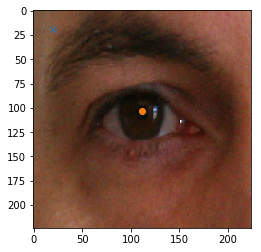

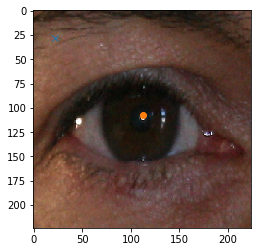

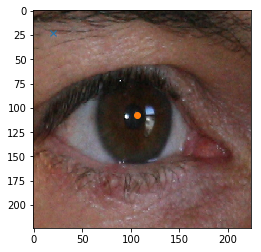

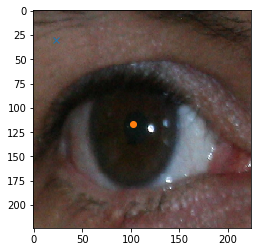

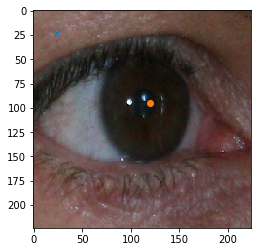

...

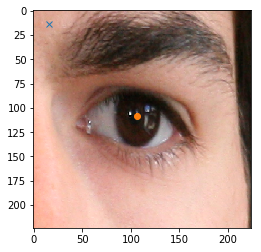

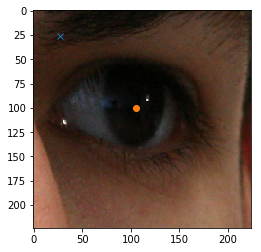

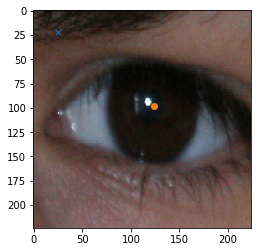

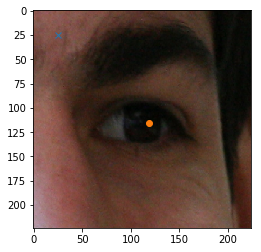

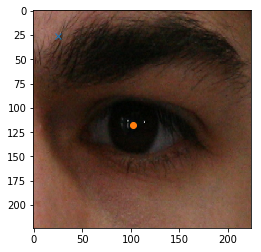

In [68]:
from PIL import Image
import matplotlib.pyplot as plt

n = 0

for i in range(len(fpaths_xs_test)):
    # テスト画像
    im1 = Image.open(fpaths_xs_test[i])
    im1 = im1.resize(target_size) 

    # Show pupil prediction
    plt.imshow(im1)
    plt.plot(outputs[i,0], outputs[i,1],'x')
    plt.plot(center_test[i,0], center_test[i,1], 'o')
    plt.show()

    n = n + 1

checkpoints_pupil_net01/history.pkl


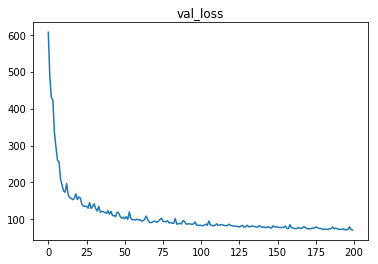

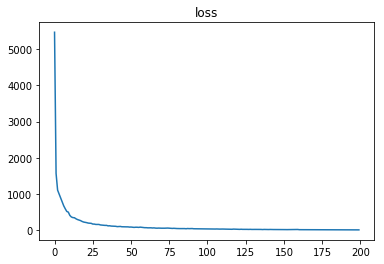

In [63]:
#
#   Show History
#
if mode == "SHOW_HISTORY":
    # load pickle
    print(dname_checkpoints + '/' + fname_history)
    history = pickle.load(open(dname_checkpoints + '/' + fname_history, 'rb'))
    
    for k in history.keys():
        plt.plot(history[k])
        plt.title(k)
        plt.show()


dict_keys(['val_loss', 'val_dice_coef', 'loss', 'dice_coef'])
